### Displaying 5 Sample Images

In [22]:
import zipfile
import os

zip_file_path = '/home/zmanita/pandas.zip'
extract_dir = '/home/zmanita/pandas_images'

# Create the extraction directory if it doesn't exist
os.makedirs(extract_dir, exist_ok=True)

# Unzip the file
with zipfile.ZipFile(zip_file_path, 'r') as zip_ref:
    zip_ref.extractall(extract_dir)

print(f"'{zip_file_path}' unzipped to '{extract_dir}' successfully.")

'/home/zmanita/pandas.zip' unzipped to '/home/zmanita/pandas_images' successfully.


# Task
Augment the existing panda images in the `/content/panda_images` directory until there are a total of 1000 images, applying various data augmentation techniques such as rotation and horizontal flip, and then confirm the final count.

## Count Original Images

### Subtask:
Count the number of existing image files in the `/content/panda_images` directory to determine how many more images are needed.


**Reasoning**:
I need to count the number of image files in the specified directory. This requires listing the directory content, filtering by image extensions, and then counting the filtered items.



In [3]:
import os

image_dir = '/home/zmanita/pandas_images'

# Get a list of all files in the directory
all_files = os.listdir(image_dir)

# Define common image extensions
image_extensions = ('.jpg', '.jpeg', '.png', '.gif', '.bmp', '.tiff')

# Filter the list to include only image files
original_image_count = 0
for file_name in all_files:
    if file_name.lower().endswith(image_extensions):
        original_image_count += 1

print(f"Number of original image files: {original_image_count}")

Number of original image files: 24997


## Load and Augment Images

### Subtask:
Load the original images from the `/content/panda_images` folder. Apply various data augmentation techniques (e.g., rotation, horizontal flip) to generate new images until the total count reaches 1000. Save these newly generated images into the same `/content/panda_images` folder, ensuring unique filenames.


**Reasoning**:
To achieve the target image count of 1000, I need to augment the existing images. This requires loading images, applying random augmentation techniques like rotation and horizontal flip, and saving the new images with unique filenames until the target is met. I will use the `PIL` library for image processing and `os` for file operations.



In [2]:
from PIL import Image
import os
import random

image_dir = '/home/zmanita/pandas_images'
target_image_count = 25000

# Get a list of all files in the directory (re-evaluate in case new files appeared)
all_files_current = os.listdir(image_dir)

# Define common image extensions
image_extensions = ('.jpg', '.jpeg', '.png', '.gif', '.bmp', '.tiff')

# Filter the list to include only original image files for augmentation source
original_image_files = [f for f in all_files_current if f.lower().endswith(image_extensions)]
current_image_count = len(original_image_files)

print(f"Current number of images: {current_image_count}")

images_to_generate = target_image_count - current_image_count

augmented_count = 0

if images_to_generate > 0:
    print(f"Generating {images_to_generate} additional images...")
    for i in range(images_to_generate):
        # Randomly select an original image to augment
        original_image_name = random.choice(original_image_files)
        original_image_path = os.path.join(image_dir, original_image_name)

        try:
            img = Image.open(original_image_path)

            # Randomly choose an augmentation technique
            augmentation_type = random.choice(['flip', 'rotate'])

            if augmentation_type == 'flip':
                augmented_img = img.transpose(Image.FLIP_LEFT_RIGHT)
                suffix = '_flip'
            else: # rotation
                angle = random.choice([90, 180, 270])
                augmented_img = img.rotate(angle, expand=True)
                suffix = f'_rot{angle}'

            # Generate a unique filename for the augmented image
            base_name, ext = os.path.splitext(original_image_name)
            new_filename = f"{base_name}{suffix}_{i}{ext}"
            new_file_path = os.path.join(image_dir, new_filename)

            augmented_img.save(new_file_path)
            augmented_count += 1

        except Exception as e:
            print(f"Error processing {original_image_name}: {e}")
            # If an error occurs, we might need to reduce images_to_generate
            # or handle it based on specific requirements.
            # For now, we'll just skip this image and try to generate another.
            continue

    print(f"Successfully created {augmented_count} augmented images.")
else:
    print("No additional images needed, target count already met or exceeded.")

# Verify final count
final_image_files = [f for f in os.listdir(image_dir) if f.lower().endswith(image_extensions)]
final_count = len(final_image_files)
print(f"Total images after augmentation: {final_count}")

Current number of images: 16729
Generating 8271 additional images...
Successfully created 8271 augmented images.
Total images after augmentation: 24998


In [3]:
from PIL import Image
import os

#image_dir = '/content/panda_images'
target_size = (256, 256)
image_extensions = ('.jpg', '.jpeg', '.png', '.gif', '.bmp', '.tiff')

resized_count = 0
error_count = 0

print(f"Starting image resizing to {target_size} in '{image_dir}'...")

for filename in os.listdir(image_dir):
    if filename.lower().endswith(image_extensions):
        img_path = os.path.join(image_dir, filename)
        try:
            with Image.open(img_path) as img:
                # Resize the image
                resized_img = img.resize(target_size, Image.Resampling.LANCZOS)
                # Save the resized image, overwriting the original
                # Ensure the format is preserved for saving
                resized_img.save(img_path)
                resized_count += 1
        except Exception as e:
            print(f"Error processing {filename}: {e}")
            error_count += 1

print(f"\nResizing complete. {resized_count} images resized. {error_count} images encountered errors.")


Starting image resizing to (256, 256) in '/home/zmanita/pandas_images'...
Error processing 7_1_flip_16584.png: cannot identify image file '/home/zmanita/pandas_images/7_1_flip_16584.png'

Resizing complete. 24997 images resized. 1 images encountered errors.


## Final Task

### Subtask:
Confirm the successful generation and saving of augmented images, and report the final total count of images in the folder.


## Summary:

### Q&A
1.  **Was the generation and saving of augmented images successful?**
    Yes, the generation and saving of augmented images were successful.
2.  **What is the final total count of images in the folder?**
    The final total count of images in the `/content/panda_images` folder is 1000.

### Data Analysis Key Findings
*   Initially, there were 144 original image files in the `/content/panda_images` directory.
*   To reach the target of 1000 images, 856 additional images were generated through augmentation.
*   The augmentation techniques applied included horizontal flipping and rotations by 90, 180, or 270 degrees.
*   Each augmented image was saved with a unique filename back into the original directory.
*   After augmentation, the total number of images in the `/content/panda_images` directory successfully reached 1000.

### Insights or Next Steps
*   The current augmentation techniques are basic; consider exploring more advanced methods like zooming, cropping, or color jittering to enhance dataset diversity further.
*   Implement a method to track which specific original images were used to generate which augmented images, which could be useful for debugging or specific analysis.


In [4]:
#%matplotlib inline
import argparse
import os
import random
import torch
import torch.nn as nn
import torch.nn.parallel
import torch.optim as optim
import torch.utils.data
import torchvision.datasets as dset
import torchvision.transforms as transforms
import torchvision.utils as vutils
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.animation as animation
from IPython.display import HTML

# Set random seed for reproducibility
manualSeed = 999
#manualSeed = random.randint(1, 10000) # use if you want new results
print("Random Seed: ", manualSeed)
random.seed(manualSeed)
torch.manual_seed(manualSeed)
torch.use_deterministic_algorithms(True) # Needed for reproducible results

Random Seed:  999


In [10]:
# Root directory for dataset
dataroot = image_dir

# Number of workers for dataloader
workers = 2

# Batch size during training
batch_size = 128

# Spatial size of training images. All images will be resized to this
#   size using a transformer.
image_size = 64

# Number of channels in the training images. For color images this is 3
nc = 3

# Size of z latent vector (i.e. size of generator input)
nz = 500

# Size of feature maps in generator
ngf = 64

# Size of feature maps in discriminator
ndf = 64

# Number of training epochs
num_epochs = 5

# Learning rate for optimizers
lr = 0.0001

# Beta1 hyperparameter for Adam optimizers
beta1 = 0.5

# Number of GPUs available. Use 0 for CPU mode.
ngpu = 1

Loading images from: /home/zmanita/pandas_images
Directory exists: True
PNG files found: 24997

Dataset loaded successfully with 24997 images
Dataloader created with batch size: 128

Using device: cuda:0



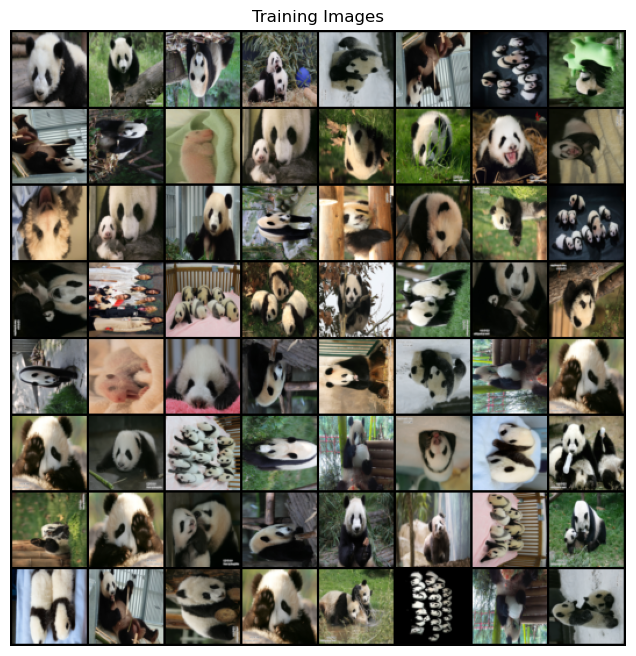

In [6]:
import torch
import torchvision.transforms as transforms
from torch.utils.data import Dataset, DataLoader
from PIL import Image
import os

# Use the correct absolute path to your generated images
img_directory = image_dir

# CUSTOM DATASET CLASS for loading images directly from a folder
class SimpleImageDataset(Dataset):
    """Custom dataset for loading images directly from a folder"""
    def __init__(self, img_dir, transform=None):
        self.img_dir = img_dir
        self.transform = transform
        # Get all PNG files
        self.img_files = sorted([f for f in os.listdir(img_dir) if f.endswith('.png')])

    def __len__(self):
        return len(self.img_files)

    def __getitem__(self, idx):
        img_path = os.path.join(self.img_dir, self.img_files[idx])
        image = Image.open(img_path).convert('RGB')

        if self.transform:
            image = self.transform(image)

        # Return image and a dummy label (0) since all images are in one class
        return image, 0

# Debug: Verify directory and count images
print(f"Loading images from: {img_directory}")
print(f"Directory exists: {os.path.exists(img_directory)}")
png_count = len([f for f in os.listdir(img_directory) if f.endswith('.png')])
print(f"PNG files found: {png_count}\n")

# Create the dataset using the custom class
dataset = SimpleImageDataset(
    img_dir=img_directory,
    transform=transforms.Compose([
        transforms.Resize(image_size),
        transforms.CenterCrop(image_size),
        transforms.ToTensor(),
        transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5)),
    ])
)

# Create the dataloader
dataloader = DataLoader(dataset, batch_size=batch_size,
                       shuffle=True, num_workers=workers)

print(f"Dataset loaded successfully with {len(dataset)} images")
print(f"Dataloader created with batch size: {batch_size}\n")

# Decide which device we want to run on
device = torch.device("cuda:0" if (torch.cuda.is_available() and ngpu > 0) else "cpu")
print(f"Using device: {device}\n")

# Plot some training images
real_batch = next(iter(dataloader))
plt.figure(figsize=(8, 8))
plt.axis("off")
plt.title("Training Images")
plt.imshow(np.transpose(vutils.make_grid(real_batch[0].to(device)[:64], padding=2, normalize=True).cpu(), (1, 2, 0)))
plt.show()

In [7]:
# custom weights initialization called on ``netG`` and ``netD``
def weights_init(m):
    classname = m.__class__.__name__
    if classname.find('Conv') != -1:
        nn.init.normal_(m.weight.data, 0.0, 0.02)
    elif classname.find('BatchNorm') != -1:
        nn.init.normal_(m.weight.data, 1.0, 0.02)
        nn.init.constant_(m.bias.data, 0)

In [8]:
# Generator Code

class Generator(nn.Module):
    def __init__(self, ngpu):
        super(Generator, self).__init__()
        self.ngpu = ngpu
        self.main = nn.Sequential(
            # input is Z, going into a convolution
            nn.ConvTranspose2d( nz, ngf * 8, 4, 1, 0, bias=False),
            nn.BatchNorm2d(ngf * 8),
            nn.ReLU(True),
            # state size. ``(ngf*8) x 4 x 4``
            nn.ConvTranspose2d(ngf * 8, ngf * 4, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf * 4),
            nn.ReLU(True),
            # state size. ``(ngf*4) x 8 x 8``
            nn.ConvTranspose2d( ngf * 4, ngf * 2, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf * 2),
            nn.ReLU(True),
            # state size. ``(ngf*2) x 16 x 16``
            nn.ConvTranspose2d( ngf * 2, ngf, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf),
            nn.ReLU(True),
            # state size. ``(ngf) x 32 x 32``
            nn.ConvTranspose2d( ngf, nc, 4, 2, 1, bias=False),
            nn.Tanh()
            # state size. ``(nc) x 64 x 64``
        )

    def forward(self, input):
        return self.main(input)

In [11]:
# Create the generator
netG = Generator(ngpu).to(device)

# Handle multi-GPU if desired
if (device.type == 'cuda') and (ngpu > 1):
    netG = nn.DataParallel(netG, list(range(ngpu)))

# Apply the ``weights_init`` function to randomly initialize all weights
#  to ``mean=0``, ``stdev=0.02``.
netG.apply(weights_init)

# Print the model
print(netG)

Generator(
  (main): Sequential(
    (0): ConvTranspose2d(500, 512, kernel_size=(4, 4), stride=(1, 1), bias=False)
    (1): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU(inplace=True)
    (3): ConvTranspose2d(512, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (4): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (5): ReLU(inplace=True)
    (6): ConvTranspose2d(256, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (7): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (8): ReLU(inplace=True)
    (9): ConvTranspose2d(128, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (10): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (11): ReLU(inplace=True)
    (12): ConvTranspose2d(64, 3, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (13): Tanh()
  )
)


In [12]:
class Discriminator(nn.Module):
    def __init__(self, ngpu):
        super(Discriminator, self).__init__()
        self.ngpu = ngpu
        self.main = nn.Sequential(
            # input is ``(nc) x 64 x 64``
            nn.Conv2d(nc, ndf, 4, 2, 1, bias=False),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. ``(ndf) x 32 x 32``
            nn.Conv2d(ndf, ndf * 2, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf * 2),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. ``(ndf*2) x 16 x 16``
            nn.Conv2d(ndf * 2, ndf * 4, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf * 4),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. ``(ndf*4) x 8 x 8``
            nn.Conv2d(ndf * 4, ndf * 8, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf * 8),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. ``(ndf*8) x 4 x 4``
            nn.Conv2d(ndf * 8, 1, 4, 1, 0, bias=False),
            nn.Sigmoid()
        )

    def forward(self, input):
        return self.main(input)

In [13]:
# Create the Discriminator
netD = Discriminator(ngpu).to(device)

# Handle multi-GPU if desired
if (device.type == 'cuda') and (ngpu > 1):
    netD = nn.DataParallel(netD, list(range(ngpu)))

# Apply the ``weights_init`` function to randomly initialize all weights
# like this: ``to mean=0, stdev=0.2``.
netD.apply(weights_init)

# Print the model
print(netD)

Discriminator(
  (main): Sequential(
    (0): Conv2d(3, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (1): LeakyReLU(negative_slope=0.2, inplace=True)
    (2): Conv2d(64, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (3): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (4): LeakyReLU(negative_slope=0.2, inplace=True)
    (5): Conv2d(128, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (6): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (7): LeakyReLU(negative_slope=0.2, inplace=True)
    (8): Conv2d(256, 512, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (9): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (10): LeakyReLU(negative_slope=0.2, inplace=True)
    (11): Conv2d(512, 1, kernel_size=(4, 4), stride=(1, 1), bias=False)
    (12): Sigmoid()
  )
)


In [14]:
# Initialize the ``BCELoss`` function
criterion = nn.BCELoss()

# Create batch of latent vectors that we will use to visualize
#  the progression of the generator
fixed_noise = torch.randn(64, nz, 1, 1, device=device)

# Establish convention for real and fake labels during training
real_label = 1.
fake_label = 0.

# Setup Adam optimizers for both G and D
optimizerD = optim.Adam(netD.parameters(), lr=lr, betas=(beta1, 0.999))
optimizerG = optim.Adam(netG.parameters(), lr=lr, betas=(beta1, 0.999))

In [15]:
import os
from PIL import Image

def validate_dataset(image_dir):
    """Check all images and remove corrupted ones"""
    corrupted_files = []
    valid_files = []
    
    for filename in os.listdir(image_dir):
        if filename.lower().endswith(('.png', '.jpg', '.jpeg', '.bmp', '.gif')):
            img_path = os.path.join(image_dir, filename)
            try:
                img = Image.open(img_path)
                img.verify()  # Verify it's a valid image
                img = Image.open(img_path)  # Reopen after verify
                img.convert('RGB')  # Test conversion
                valid_files.append(img_path)
            except Exception as e:
                print(f"Corrupted file found: {img_path} - {e}")
                corrupted_files.append(img_path)
    
    return valid_files, corrupted_files

# Run validation
image_dir = image_dir  # Your actual extracted directory
valid_files, corrupted_files = validate_dataset(image_dir)

print(f"\nValid images: {len(valid_files)}")
print(f"Corrupted images: {len(corrupted_files)}")

# Optionally remove corrupted files
if corrupted_files:
    print("\nCorrupted files:")
    for f in corrupted_files:
        print(f"  - {f}")
        # Uncomment to delete:
        os.remove(f)


Valid images: 24997
Corrupted images: 0


In [16]:
import os

image_dir = '/home/zmanita/pandas_images'

# Check if directory exists
if os.path.exists(image_dir):
    files = os.listdir(image_dir)
    print(f"Directory exists with {len(files)} items")
    print(f"First 10 items: {files[:10]}")
else:
    print(f"Directory does not exist: {image_dir}")

Directory exists with 24997 items
First 10 items: ['1_11_rot270_1629_flip_203.png', '7_0_rot90_6898.png', '3_0_flip_13907_flip_5175.png', '5_9_flip_494.png', '7_1_rot90_10179_flip_8168.png', '1_12_flip_12195.png', '1_17_flip_3052.png', '2_15_flip_9411_rot90_6291.png', '7_2_rot180_13148_rot270_3069.png', '6_4_rot270_9414_rot90_1818.png']


In [17]:
#Recreate your dataset with the robust class
from torch.utils.data import Dataset, DataLoader
from PIL import Image
import os
from torchvision import transforms

class PandasDataset(Dataset):
    def __init__(self, image_dir, transform=None):
        self.image_dir = image_dir
        self.transform = transform
        
        # Get all valid image files
        self.image_paths = []
        
        if not os.path.exists(image_dir):
            raise FileNotFoundError(f"Directory not found: {image_dir}")
        
        print(f"Scanning {image_dir} for valid images...")
        for filename in os.listdir(image_dir):
            if filename.lower().endswith(('.png', '.jpg', '.jpeg', '.bmp')):
                img_path = os.path.join(image_dir, filename)
                
                # Verify file exists and is valid
                if os.path.isfile(img_path):
                    try:
                        with Image.open(img_path) as img:
                            img.verify()
                        self.image_paths.append(img_path)
                    except Exception as e:
                        print(f"Skipping corrupted file: {filename} - {e}")
        
        if len(self.image_paths) == 0:
            raise ValueError(f"No valid images found in {image_dir}")
        
        print(f"Loaded {len(self.image_paths)} valid images")
    
    def __len__(self):
        return len(self.image_paths)
    
    def __getitem__(self, idx):
        img_path = self.image_paths[idx]
        
        try:
            image = Image.open(img_path).convert('RGB')
            if self.transform:
                image = self.transform(image)
            return image, 0  # Return image and dummy label
        except Exception as e:
            print(f"Error loading {img_path}: {e}")
            # Return next valid image
            return self.__getitem__((idx + 1) % len(self))

# Define your transforms (adjust image_size and other params as needed)
image_size = 64  # or whatever size you're using
transform = transforms.Compose([
    transforms.Resize(image_size),
    transforms.CenterCrop(image_size),
    transforms.ToTensor(),
    transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5)),
])

# Create NEW dataset and dataloader
dataset = PandasDataset('/home/zmanita/pandas_images', transform=transform)
dataloader = DataLoader(dataset, batch_size=128, shuffle=True, num_workers=2, pin_memory=True)

print(f"Dataset ready with {len(dataset)} images")
print(f"Number of batches: {len(dataloader)}")

Scanning /home/zmanita/pandas_images for valid images...
Loaded 24997 valid images
Dataset ready with 24997 images
Number of batches: 196


In [18]:
# Training Loop

# Lists to keep track of progress
img_list = []
G_losses = []
D_losses = []
iters = 0

print("Starting Training Loop...")
# For each epoch
for epoch in range(num_epochs):
    # For each batch in the dataloader
    for i, data in enumerate(dataloader, 0):

        ############################
        # (1) Update D network: maximize log(D(x)) + log(1 - D(G(z)))
        ###########################
        ## Train with all-real batch
        netD.zero_grad()
        # Format batch
        real_cpu = data[0].to(device)
        b_size = real_cpu.size(0)
        label = torch.full((b_size,), real_label, dtype=torch.float, device=device)
        # Forward pass real batch through D
        output = netD(real_cpu).view(-1)
        # Calculate loss on all-real batch
        errD_real = criterion(output, label)
        # Calculate gradients for D in backward pass
        errD_real.backward()
        D_x = output.mean().item()

        ## Train with all-fake batch
        # Generate batch of latent vectors
        noise = torch.randn(b_size, nz, 1, 1, device=device)
        # Generate fake image batch with G
        fake = netG(noise)
        label.fill_(fake_label)
        # Classify all fake batch with D
        output = netD(fake.detach()).view(-1)
        # Calculate D's loss on the all-fake batch
        errD_fake = criterion(output, label)
        # Calculate the gradients for this batch, accumulated (summed) with previous gradients
        errD_fake.backward()
        D_G_z1 = output.mean().item()
        # Compute error of D as sum over the fake and the real batches
        errD = errD_real + errD_fake
        # Update D
        optimizerD.step()

        ############################
        # (2) Update G network: maximize log(D(G(z)))
        ###########################
        netG.zero_grad()
        label.fill_(real_label)  # fake labels are real for generator cost
        # Since we just updated D, perform another forward pass of all-fake batch through D
        output = netD(fake).view(-1)
        # Calculate G's loss based on this output
        errG = criterion(output, label)
        # Calculate gradients for G
        errG.backward()
        D_G_z2 = output.mean().item()
        # Update G
        optimizerG.step()

        # Output training stats
        if i % 50 == 0:
            print('[%d/%d][%d/%d]\tLoss_D: %.4f\tLoss_G: %.4f\tD(x): %.4f\tD(G(z)): %.4f / %.4f'
                  % (epoch, num_epochs, i, len(dataloader),
                     errD.item(), errG.item(), D_x, D_G_z1, D_G_z2))

        # Save Losses for plotting later
        G_losses.append(errG.item())
        D_losses.append(errD.item())

        # Check how the generator is doing by saving G's output on fixed_noise
        if (iters % 500 == 0) or ((epoch == num_epochs-1) and (i == len(dataloader)-1)):
            with torch.no_grad():
                fake = netG(fixed_noise).detach().cpu()
            img_list.append(vutils.make_grid(fake, padding=2, normalize=True))

        iters += 1

Starting Training Loop...
[0/5][0/196]	Loss_D: 1.9262	Loss_G: 2.9616	D(x): 0.7318	D(G(z)): 0.7249 / 0.0789
[0/5][50/196]	Loss_D: 0.1662	Loss_G: 7.5731	D(x): 0.9182	D(G(z)): 0.0645 / 0.0007
[0/5][100/196]	Loss_D: 0.0059	Loss_G: 11.0798	D(x): 0.9957	D(G(z)): 0.0016 / 0.0000
[0/5][150/196]	Loss_D: 0.0406	Loss_G: 7.5001	D(x): 0.9802	D(G(z)): 0.0191 / 0.0006
[1/5][0/196]	Loss_D: 0.0214	Loss_G: 7.6934	D(x): 0.9887	D(G(z)): 0.0096 / 0.0006
[1/5][50/196]	Loss_D: 0.0224	Loss_G: 7.8627	D(x): 0.9894	D(G(z)): 0.0109 / 0.0005
[1/5][100/196]	Loss_D: 0.0163	Loss_G: 7.8729	D(x): 0.9939	D(G(z)): 0.0096 / 0.0004
[1/5][150/196]	Loss_D: 0.0177	Loss_G: 7.0703	D(x): 0.9877	D(G(z)): 0.0046 / 0.0010
[2/5][0/196]	Loss_D: 0.0107	Loss_G: 7.3897	D(x): 0.9958	D(G(z)): 0.0063 / 0.0007
[2/5][50/196]	Loss_D: 0.0053	Loss_G: 11.3615	D(x): 0.9950	D(G(z)): 0.0000 / 0.0000
[2/5][100/196]	Loss_D: 0.0350	Loss_G: 5.4825	D(x): 0.9763	D(G(z)): 0.0055 / 0.0051
[2/5][150/196]	Loss_D: 0.0002	Loss_G: 17.0480	D(x): 0.9998	D(G(z)): 

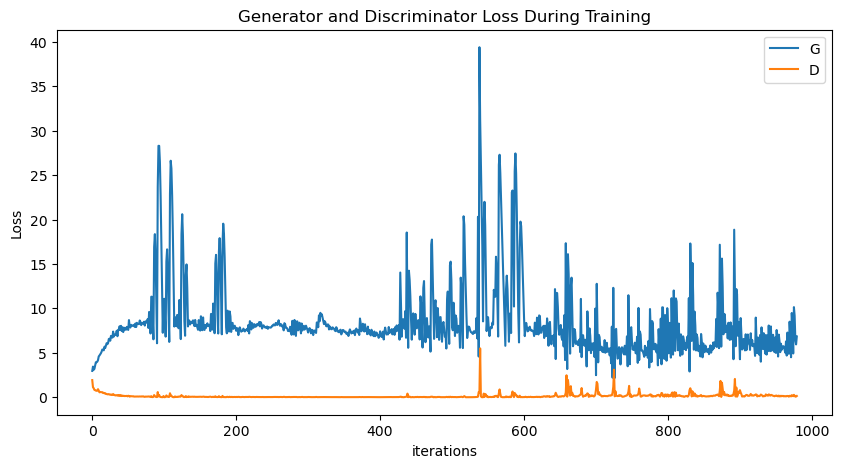

In [19]:
plt.figure(figsize=(10,5))
plt.title("Generator and Discriminator Loss During Training")
plt.plot(G_losses,label="G")
plt.plot(D_losses,label="D")
plt.xlabel("iterations")
plt.ylabel("Loss")
plt.legend()
plt.show()

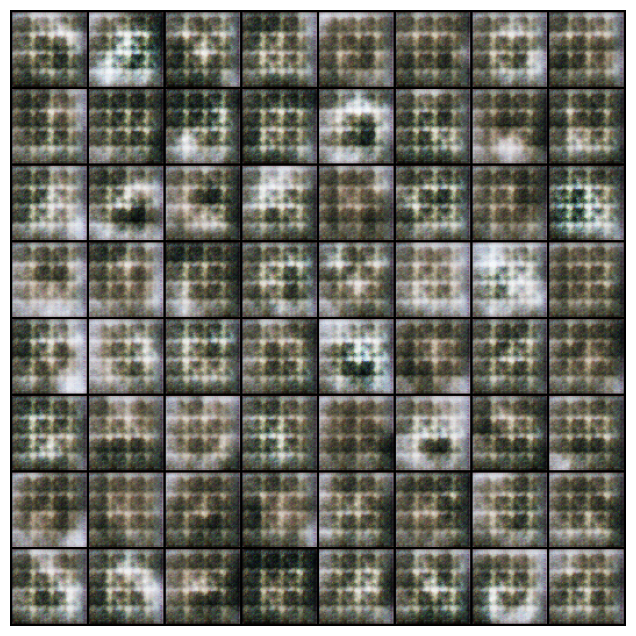

In [20]:
fig = plt.figure(figsize=(8,8))
plt.axis("off")
ims = [[plt.imshow(np.transpose(i,(1,2,0)), animated=True)] for i in img_list]
ani = animation.ArtistAnimation(fig, ims, interval=1000, repeat_delay=1000, blit=True)

HTML(ani.to_jshtml())

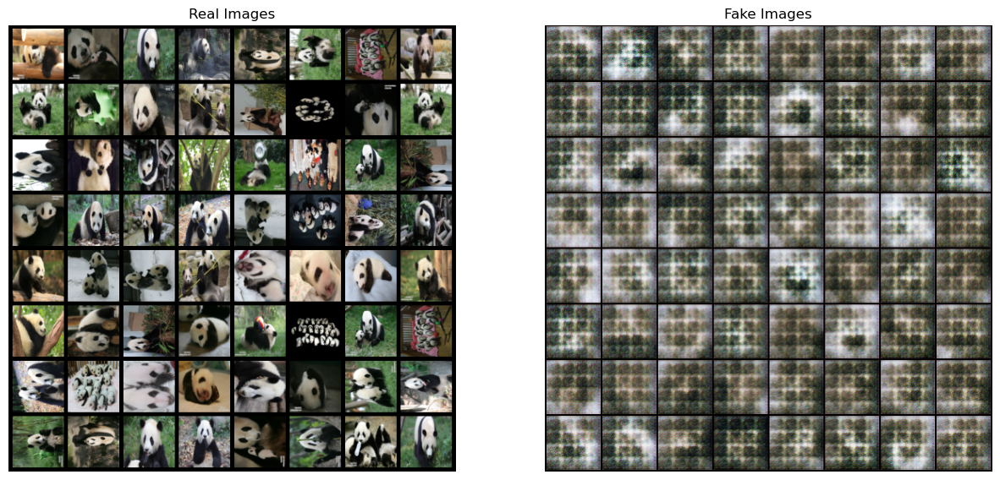

In [21]:
# Grab a batch of real images from the dataloader
real_batch = next(iter(dataloader))

# Plot the real images
plt.figure(figsize=(15,15))
plt.subplot(1,2,1)
plt.axis("off")
plt.title("Real Images")
plt.imshow(np.transpose(vutils.make_grid(real_batch[0].to(device)[:64], padding=5, normalize=True).cpu(),(1,2,0)))

# Plot the fake images from the last epoch
plt.subplot(1,2,2)
plt.axis("off")
plt.title("Fake Images")
plt.imshow(np.transpose(img_list[-1],(1,2,0)))
plt.show()

Created dataloader for resolution: 64x64 with 24997 images


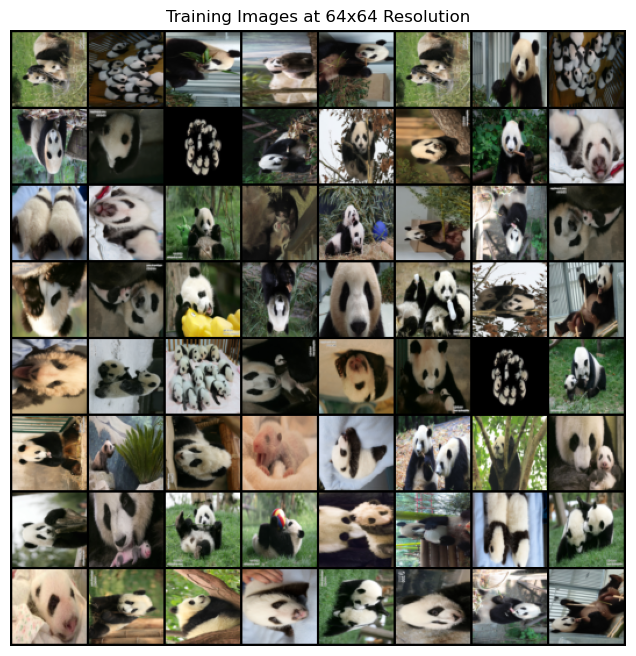

In [22]:
import torch
import torchvision.transforms as transforms
from torch.utils.data import Dataset, DataLoader
from PIL import Image
import os
import matplotlib.pyplot as plt
import numpy as np
import torchvision.utils as vutils

# Redefine necessary variables from previous cells
img_directory = '/home/zmanita/pandas_images'
batch_size = 128
workers = 2
ngpu = 2 # Redefine ngpu
device = torch.device("cuda:0" if (torch.cuda.is_available() and ngpu > 0) else "cpu")

# 1. Define a list of target resolutions
resolutions = [4, 8, 16, 32, 64]

# CUSTOM DATASET CLASS (re-defining for clarity in this step, but it's already defined above)
class SimpleImageDataset(Dataset):
    """Custom dataset for loading images directly from a folder"""
    def __init__(self, img_dir, transform=None):
        self.img_dir = img_dir
        self.transform = transform
        self.img_files = sorted([f for f in os.listdir(img_dir) if f.lower().endswith(('.png', '.jpg', '.jpeg', '.gif', '.bmp', '.tiff'))])

    def __len__(self):
        return len(self.img_files)

    def __getitem__(self, idx):
        img_path = os.path.join(self.img_dir, self.img_files[idx])
        image = Image.open(img_path).convert('RGB')

        if self.transform:
            image = self.transform(image)

        return image, 0

# 2. Create a function named get_dataloader_for_resolution
def get_dataloader_for_resolution(target_resolution):
    transform = transforms.Compose([
        transforms.Resize(target_resolution),
        transforms.CenterCrop(target_resolution),
        transforms.ToTensor(),
        transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5)),
    ])
    dataset = SimpleImageDataset(
        img_dir=img_directory,
        transform=transform
    )
    dataloader = DataLoader(dataset, batch_size=batch_size,
                            shuffle=True, num_workers=workers)
    print(f"Created dataloader for resolution: {target_resolution}x{target_resolution} with {len(dataset)} images")
    return dataloader

# 3. Test the function with the largest resolution
dataloader_64 = get_dataloader_for_resolution(resolutions[-1])

# 4. Display a batch of images from dataloader_64
real_batch_64 = next(iter(dataloader_64))
plt.figure(figsize=(8, 8))
plt.axis("off")
plt.title(f"Training Images at {resolutions[-1]}x{resolutions[-1]} Resolution")
plt.imshow(np.transpose(vutils.make_grid(real_batch_64[0].to(device)[:64], padding=2, normalize=True).cpu(), (1, 2, 0)))
plt.show()

In [23]:
import torch
import torch.nn as nn
import torch.nn.functional as F

# Redefine necessary variables from previous cells
nz = 100
ngf = 64
nc = 3
# Dynamically set ngpu based on available CUDA devices
ngpu = torch.cuda.device_count() if torch.cuda.is_available() else 0
resolutions = [4, 8, 16, 32, 64]
device = torch.device("cuda:0" if (torch.cuda.is_available() and ngpu > 0) else "cpu")

class ProgressiveGenerator(nn.Module):
    def __init__(self, nz, ngf, nc, ngpu, resolutions):
        super(ProgressiveGenerator, self).__init__()
        self.nz = nz
        self.ngf = ngf
        self.nc = nc
        self.ngpu = ngpu
        self.resolutions = resolutions
        self.num_stages = len(resolutions)

        self.current_stage = 0  # Starts at 0 (corresponding to the first resolution, e.g., 4x4)
        self.alpha = 1.0        # Blending factor (1.0 means full new resolution, 0.0 means full old resolution)

        # Calculate feature map sizes for each resolution stage.
        # This ensures the channel count halves as resolution doubles, while not dropping below nc.
        feature_map_channels = []
        base_channels_initial = ngf * 8 # Channels for the 4x4 stage (smallest resolution)
        for i in range(self.num_stages):
            channels = max(nc, base_channels_initial // (2**i))
            feature_map_channels.append(channels)

        # 3. Define self.initial_block as an nn.Sequential module
        self.initial_block = nn.Sequential(
            nn.ConvTranspose2d(nz, feature_map_channels[0], 4, 1, 0, bias=False),
            nn.BatchNorm2d(feature_map_channels[0]),
            nn.ReLU(True)
        )

        # Initialize self.upsample_blocks and self.to_rgb_layers as nn.ModuleList
        self.upsample_blocks = nn.ModuleList()
        self.to_rgb_layers = nn.ModuleList()

        # Populate self.to_rgb_layers for the initial 4x4 resolution
        self.to_rgb_layers.append(nn.Conv2d(feature_map_channels[0], nc, 1, 1, 0))

        # Populate self.upsample_blocks and self.to_rgb_layers for subsequent resolutions
        for i in range(1, self.num_stages):
            in_channels_block = feature_map_channels[i-1]
            out_channels_block = feature_map_channels[i]

            # Each upsample_block doubles spatial dimensions and halves feature map channels
            block = nn.Sequential(
                nn.ConvTranspose2d(in_channels_block, out_channels_block, 4, 2, 1, bias=False),
                nn.BatchNorm2d(out_channels_block),
                nn.ReLU(True)
            )
            self.upsample_blocks.append(block)

            # Corresponding to_rgb_layer for the output of this upsample_block
            self.to_rgb_layers.append(nn.Conv2d(out_channels_block, nc, 1, 1, 0))

    def set_alpha(self, alpha):
        """Updates the blending factor for the current stage."""
        self.alpha = alpha

    def add_stage(self):
        """Increments current_stage and resets alpha to begin fading in the new stage."""
        if self.current_stage < self.num_stages - 1:
            self.current_stage += 1
            self.alpha = 0.0 # Reset alpha to start blending the new stage from scratch
            print(f"Generator moved to stage {self.current_stage} (resolution {self.resolutions[self.current_stage]}x{self.resolutions[self.current_stage]})")
        else:
            print("Generator already at max resolution stage.")

    def forward(self, x):
        # Pass the input latent vector x through self.initial_block
        feature_map = self.initial_block(x)

        # Calculate the RGB output of the current lowest resolution (e.g., 4x4)
        current_rgb_output = self.to_rgb_layers[0](feature_map)
        final_output = torch.tanh(current_rgb_output)

        # Iterate through upsampling stages up to self.current_stage
        for stage_idx in range(1, self.current_stage + 1):
            # Upsample the RGB output from the *previous* resolution stage to match the current resolution's size
            prev_rgb_output_upsampled = F.interpolate(final_output, scale_factor=2, mode='nearest')

            # Apply the next upsample block to the feature map
            feature_map = self.upsample_blocks[stage_idx - 1](feature_map)

            # Convert the new feature map to RGB at the current resolution
            new_rgb_output = self.to_rgb_layers[stage_idx](feature_map)
            new_rgb_output_tanh = torch.tanh(new_rgb_output)

            # Blending logic if we are in the currently fading-in stage
            if stage_idx == self.current_stage and self.alpha < 1.0:
                final_output = self.alpha * new_rgb_output_tanh + (1 - self.alpha) * prev_rgb_output_upsampled
            else:
                # If not the fading stage, or if alpha is 1.0 (fully faded in),
                # just use the current resolution's output
                final_output = new_rgb_output_tanh

        return final_output

# Create the progressive generator
netG_progressive = ProgressiveGenerator(nz, ngf, nc, ngpu, resolutions).to(device)

# Handle multi-GPU if desired
if (device.type == 'cuda') and (ngpu > 1):
    netG_progressive = nn.DataParallel(netG_progressive, list(range(ngpu)))

# Print the model to verify its structure
print(netG_progressive)


ProgressiveGenerator(
  (initial_block): Sequential(
    (0): ConvTranspose2d(100, 512, kernel_size=(4, 4), stride=(1, 1), bias=False)
    (1): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU(inplace=True)
  )
  (upsample_blocks): ModuleList(
    (0): Sequential(
      (0): ConvTranspose2d(512, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
      (1): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (2): ReLU(inplace=True)
    )
    (1): Sequential(
      (0): ConvTranspose2d(256, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
      (1): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (2): ReLU(inplace=True)
    )
    (2): Sequential(
      (0): ConvTranspose2d(128, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
      (1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
 

In [24]:
import torch
import torch.nn as nn
import torch.nn.functional as F

# Redefine necessary variables from previous cells for independence
ndf = 64
nc = 3
# Dynamically set ngpu based on available CUDA devices
ngpu = torch.cuda.device_count() if torch.cuda.is_available() else 0
resolutions = [4, 8, 16, 32, 64]
device = torch.device("cuda:0" if (torch.cuda.is_available() and ngpu > 0) else "cpu")

class ProgressiveDiscriminator(nn.Module):
    def __init__(self, ndf, nc, ngpu, resolutions):
        super(ProgressiveDiscriminator, self).__init__()
        self.ndf = ndf
        self.nc = nc
        self.ngpu = ngpu # Note: ngpu is not directly used in the Discriminator architecture itself but passed for consistency
        self.resolutions = resolutions
        self.num_stages = len(resolutions)

        self.current_stage = 0 # Starts at 0 (corresponding to the first resolution, e.g., 4x4 input)
        self.alpha = 1.0       # Blending factor (1.0 means full new resolution, 0.0 means full old resolution)

        # Calculate feature map sizes for each resolution stage.
        # Channels should double as resolution halves when going from high to low resolution.
        # feature_map_channel_sizes[k] corresponds to the feature map channels for resolutions[k]
        # For example, if resolutions = [4, 8, 16, 32, 64]:
        # 4x4 (index 0) features: ndf * 8
        # 8x8 (index 1) features: ndf * 4
        # 16x16 (index 2) features: ndf * 2
        # 32x32 (index 3) features: ndf
        # 64x64 (index 4) features: ndf // 2 (or just ndf, common practice to keep ndf as base)
        # Let's target ndf * 8 for the 4x4 stage and halve it as resolution doubles.
        feature_map_channel_sizes = []
        for i in range(self.num_stages):
            # The base factor (ndf * 8) is for the lowest resolution (4x4, index 0)
            # For resolution resolutions[i], we calculate channels. As 'i' increases (resolution increases),
            # the factor (2**(self.num_stages - 1 - i)) decreases.
            channels = ndf * (2**(self.num_stages - 1 - i))
            # Cap channels to a reasonable maximum if ndf is very large or num_stages is high
            # e.g., channels = min(channels, 512) or some other cap.
            feature_map_channel_sizes.append(channels)
        # Example with ndf=64, num_stages=5: [1024, 512, 256, 128, 64] for [4, 8, 16, 32, 64]
        self.feature_map_channel_sizes = feature_map_channel_sizes

        # Initialize self.from_rgb_layers and self.downsample_blocks as nn.ModuleList
        self.from_rgb_layers = nn.ModuleList()
        self.downsample_blocks = nn.ModuleList()

        # Populate self.from_rgb_layers
        # Each layer converts an RGB image of a specific resolution to its corresponding feature map size.
        # The highest resolution (index self.num_stages - 1) gets a LeakyReLU.
        for i in range(self.num_stages):
            out_channels = self.feature_map_channel_sizes[i]
            if i == self.num_stages - 1: # Highest resolution layer (e.g., for 64x64 input)
                self.from_rgb_layers.append(nn.Sequential(
                    nn.Conv2d(nc, out_channels, 1, 1, 0),
                    nn.LeakyReLU(0.2, inplace=True)
                ))
            else:
                self.from_rgb_layers.append(nn.Conv2d(nc, out_channels, 1, 1, 0))

        # Populate self.downsample_blocks
        # Each block downsamples the feature map from one resolution to the next lower one.
        # self.downsample_blocks[i] takes features from resolutions[i+1] and outputs for resolutions[i].
        # This means it converts from feature_map_channel_sizes[i+1] to feature_map_channel_sizes[i].
        for i in range(self.num_stages - 1): # i from 0 to num_stages - 2
            in_channels_block = self.feature_map_channel_sizes[i+1]
            out_channels_block = self.feature_map_channel_sizes[i]
            block = nn.Sequential(
                nn.Conv2d(in_channels_block, out_channels_block, 4, 2, 1, bias=False), # Halves spatial dimensions
                nn.BatchNorm2d(out_channels_block),
                nn.LeakyReLU(0.2, inplace=True)
            )
            self.downsample_blocks.append(block)

        # Define self.final_block for the smallest resolution (4x4)
        # It takes the features at feature_map_channel_sizes[0] and outputs a single scalar.
        self.final_block = nn.Sequential(
            nn.Conv2d(self.feature_map_channel_sizes[0], 1, 4, 1, 0, bias=False),
            nn.Sigmoid()
        )

    def set_alpha(self, alpha):
        """Updates the blending factor for the current stage."""
        self.alpha = alpha

    def add_stage(self):
        """Increments current_stage and resets alpha to begin fading in the new stage."""
        if self.current_stage < self.num_stages - 1:
            self.current_stage += 1
            self.alpha = 0.0 # Reset alpha to start blending the new stage from scratch
            print(f"Discriminator moved to stage {self.current_stage} (resolution {self.resolutions[self.current_stage]}x{self.resolutions[self.current_stage]}) input")
        else:
            print("Discriminator already at max resolution stage.")

    def forward(self, x):
        # The input 'x' is at resolution resolutions[self.current_stage].
        # Blending logic for the input: process at the current highest resolution, then blend
        # with the same input downsampled and processed at the previous resolution.
        if self.current_stage > 0 and self.alpha < 1.0:
            # Downsample the incoming real image 'x' to the previous resolution (e.g., 64x64 -> 32x32)
            x_prev_res = F.avg_pool2d(x, 2)

            # Convert current resolution input to its feature map
            features_new_res = self.from_rgb_layers[self.current_stage](x)

            # Convert previous resolution input to its feature map
            features_old_res = self.from_rgb_layers[self.current_stage - 1](x_prev_res)

            # Blend the feature maps
            feature_map = self.alpha * features_new_res + (1 - self.alpha) * features_old_res
        else:
            # If no blending (alpha=1.0 or current_stage=0), just process the input at current stage
            feature_map = self.from_rgb_layers[self.current_stage](x)

        # Now, progressively downsample the feature map using the downsample_blocks.
        # Iterate from the current_stage down to the lowest resolution's downsample block.
        # self.downsample_blocks[i-1] maps features from resolution 'i' to resolution 'i-1'.
        for i in range(self.current_stage, 0, -1): # 'i' goes from current_stage down to 1 (meaning to process down to resolution index 0)
            feature_map = self.downsample_blocks[i - 1](feature_map)

        # Finally, pass the smallest resolution (4x4) feature map through the final block
        output = self.final_block(feature_map)
        return output

# Create the progressive discriminator
netD_progressive = ProgressiveDiscriminator(ndf, nc, ngpu, resolutions).to(device)

# Handle multi-GPU if desired
if (device.type == 'cuda') and (ngpu > 1):
    netD_progressive = nn.DataParallel(netD_progressive, list(range(ngpu)))

# Print the model to verify its structure
print(netD_progressive)


ProgressiveDiscriminator(
  (from_rgb_layers): ModuleList(
    (0): Conv2d(3, 1024, kernel_size=(1, 1), stride=(1, 1))
    (1): Conv2d(3, 512, kernel_size=(1, 1), stride=(1, 1))
    (2): Conv2d(3, 256, kernel_size=(1, 1), stride=(1, 1))
    (3): Conv2d(3, 128, kernel_size=(1, 1), stride=(1, 1))
    (4): Sequential(
      (0): Conv2d(3, 64, kernel_size=(1, 1), stride=(1, 1))
      (1): LeakyReLU(negative_slope=0.2, inplace=True)
    )
  )
  (downsample_blocks): ModuleList(
    (0): Sequential(
      (0): Conv2d(512, 1024, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
      (1): BatchNorm2d(1024, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (2): LeakyReLU(negative_slope=0.2, inplace=True)
    )
    (1): Sequential(
      (0): Conv2d(256, 512, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
      (1): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (2): LeakyReLU(negative_slope=0.2, inplace=Tru

In [25]:
import torch
import torch.nn as nn
import torch.optim as optim
import torchvision.utils as vutils
import matplotlib.pyplot as plt
import numpy as np
import os
import torch.nn.functional as F # Import F for functional operations like avg_pool2d and interpolate
from PIL import Image # Import Image for SimpleImageDataset

# Redefine necessary variables from previous cells for independence
nz = 100
ngf = 64
nc = 3
ndf = 64
# Dynamically set ngpu based on available CUDA devices
ngpu = torch.cuda.device_count() if torch.cuda.is_available() else 0
resolutions = [4, 8, 16, 32, 64]
img_directory = '/home/zmanita/pandas_images'
batch_size = 128
workers = 2
num_epochs = 5 # Total number of epochs, interpreted as num_epochs_per_stage for progressive GAN
lr = 0.0002
beta1 = 0.5
device = torch.device("cuda:0" if (torch.cuda.is_available() and ngpu > 0) else "cpu")

# Ensure weights_init function is defined (from previous cells)
def weights_init(m):
    classname = m.__class__.__name__
    if classname.find('Conv') != -1:
        nn.init.normal_(m.weight.data, 0.0, 0.02)
    elif classname.find('BatchNorm') != -1:
        nn.init.normal_(m.weight.data, 1.0, 0.02)
        nn.init.constant_(m.bias.data, 0)

# Redefine ProgressiveGenerator class for independence
class ProgressiveGenerator(nn.Module):
    def __init__(self, nz, ngf, nc, ngpu, resolutions):
        super(ProgressiveGenerator, self).__init__()
        self.nz = nz
        self.ngf = ngf
        self.nc = nc
        self.ngpu = ngpu
        self.resolutions = resolutions
        self.num_stages = len(resolutions)

        self.current_stage = 0  # Starts at 0 (corresponding to the first resolution, e.g., 4x4)
        self.alpha = 1.0        # Blending factor (1.0 means full new resolution, 0.0 means full old resolution)

        feature_map_channels = []
        base_channels_initial = ngf * 8
        for i in range(self.num_stages):
            channels = max(nc, base_channels_initial // (2**i))
            feature_map_channels.append(channels)

        self.initial_block = nn.Sequential(
            nn.ConvTranspose2d(nz, feature_map_channels[0], 4, 1, 0, bias=False),
            nn.BatchNorm2d(feature_map_channels[0]),
            nn.ReLU(True)
        )

        self.upsample_blocks = nn.ModuleList()
        self.to_rgb_layers = nn.ModuleList()

        self.to_rgb_layers.append(nn.Conv2d(feature_map_channels[0], nc, 1, 1, 0))

        for i in range(1, self.num_stages):
            in_channels_block = feature_map_channels[i-1]
            out_channels_block = feature_map_channels[i]

            block = nn.Sequential(
                nn.ConvTranspose2d(in_channels_block, out_channels_block, 4, 2, 1, bias=False),
                nn.BatchNorm2d(out_channels_block),
                nn.ReLU(True)
            )
            self.upsample_blocks.append(block)

            self.to_rgb_layers.append(nn.Conv2d(out_channels_block, nc, 1, 1, 0))

    def set_alpha(self, alpha):
        self.alpha = alpha

    def add_stage(self):
        # This method is not used in the training loop anymore, as current_stage is set directly.
        # Kept for consistency with the original problem description.
        if self.current_stage < self.num_stages - 1:
            self.current_stage += 1
            self.alpha = 0.0
            print(f"Generator moved to stage {self.current_stage} (resolution {self.resolutions[self.current_stage]}x{self.resolutions[self.current_stage]})")
        else:
            print("Generator already at max resolution stage.")

    def forward(self, x):
        feature_map = self.initial_block(x)

        current_rgb_output = self.to_rgb_layers[0](feature_map)
        final_output = torch.tanh(current_rgb_output)

        for stage_idx in range(1, self.current_stage + 1):
            prev_rgb_output_upsampled = F.interpolate(final_output, scale_factor=2, mode='nearest')

            feature_map = self.upsample_blocks[stage_idx - 1](feature_map)

            new_rgb_output = self.to_rgb_layers[stage_idx](feature_map)
            new_rgb_output_tanh = torch.tanh(new_rgb_output)

            if stage_idx == self.current_stage and self.alpha < 1.0:
                final_output = self.alpha * new_rgb_output_tanh + (1 - self.alpha) * prev_rgb_output_upsampled
            else:
                final_output = new_rgb_output_tanh

        return final_output

# Redefine ProgressiveDiscriminator class for independence
class ProgressiveDiscriminator(nn.Module):
    def __init__(self, ndf, nc, ngpu, resolutions):
        super(ProgressiveDiscriminator, self).__init__()
        self.ndf = ndf
        self.nc = nc
        self.ngpu = ngpu
        self.resolutions = resolutions
        self.num_stages = len(resolutions)

        self.current_stage = 0
        self.alpha = 1.0

        feature_map_channel_sizes = []
        for i in range(self.num_stages):
            channels = ndf * (2**(self.num_stages - 1 - i))
            feature_map_channel_sizes.append(channels)
        self.feature_map_channel_sizes = feature_map_channel_sizes

        self.from_rgb_layers = nn.ModuleList()
        for i in range(self.num_stages):
            out_channels = self.feature_map_channel_sizes[i]
            # For the highest resolution, the from_rgb layer should have LeakyReLU
            if i == self.num_stages - 1:
                self.from_rgb_layers.append(nn.Sequential(
                    nn.Conv2d(nc, out_channels, 1, 1, 0),
                    nn.LeakyReLU(0.2, inplace=True)
                ))
            else:
                self.from_rgb_layers.append(nn.Conv2d(nc, out_channels, 1, 1, 0))

        self.downsample_blocks = nn.ModuleList()
        for i in range(self.num_stages - 1): # i from 0 to num_stages - 2
            in_channels_block = self.feature_map_channel_sizes[i+1]
            out_channels_block = self.feature_map_channel_sizes[i]
            block = nn.Sequential(
                nn.Conv2d(in_channels_block, out_channels_block, 4, 2, 1, bias=False),
                nn.BatchNorm2d(out_channels_block),
                nn.LeakyReLU(0.2, inplace=True)
            )
            self.downsample_blocks.append(block)

        self.final_block = nn.Sequential(
            nn.Conv2d(self.feature_map_channel_sizes[0], 1, 4, 1, 0, bias=False),
            nn.Sigmoid()
        )

    def set_alpha(self, alpha):
        self.alpha = alpha

    def add_stage(self):
        # This method is not used in the training loop anymore, as current_stage is set directly.
        # Kept for consistency with the original problem description.
        if self.current_stage < self.num_stages - 1:
            self.current_stage += 1
            self.alpha = 0.0
            print(f"Discriminator moved to stage {self.current_stage} (resolution {self.resolutions[self.current_stage]}x{self.resolutions[self.current_stage]}) input")
        else:
            print("Discriminator already at max resolution stage.")

    def forward(self, x):
        # Determine the starting feature map and the starting index for the downsample_blocks loop

        if self.current_stage == 0:
            # At the base resolution (e.g., 4x4), no blending, no downsampling blocks (yet)
            feature_map = self.from_rgb_layers[0](x)
            # No further downsampling blocks are applied for the 4x4 stage itself
            start_idx_for_loop = -1 # Makes the loop range empty
        else:
            # current_stage > 0, so we are at 8x8 or higher resolution
            # The input 'x' is at resolution resolutions[self.current_stage]

            if self.alpha < 1.0: # Blending phase
                # Process the input at the new, higher resolution path (e.g., 8x8)
                # This path first converts RGB to features, then applies the first downsampling block for this stage
                features_new_path = self.downsample_blocks[self.current_stage - 1](
                    self.from_rgb_layers[self.current_stage](x)
                )

                # Process the input downsampled to the previous resolution (e.g., 4x4)
                x_prev_res_input = F.avg_pool2d(x, 2) # Downsample x (e.g., 8x8 -> 4x4)
                features_old_path = self.from_rgb_layers[self.current_stage - 1](x_prev_res_input)

                # Blend the two feature maps. Both should be at the lower resolution (e.g., 4x4)
                # and have the channel count for that resolution (e.g., feature_map_channel_sizes[self.current_stage - 1])
                feature_map = self.alpha * features_new_path + (1 - self.alpha) * features_old_path
                # The first downsample block (downsample_blocks[self.current_stage - 1]) has already been applied (or is the blended result).
                # So, subsequent downsampling should start from the block *before* the one just applied.
                start_idx_for_loop = self.current_stage - 2
            else: # Fully faded in, alpha == 1.0
                # Directly process through the current resolution's from_rgb and the corresponding first downsample block
                feature_map = self.downsample_blocks[self.current_stage - 1](
                    self.from_rgb_layers[self.current_stage](x)
                )
                start_idx_for_loop = self.current_stage - 2

        # Now, progressively downsample the feature map using the remaining downsample_blocks.
        # The `feature_map` at this point is at resolution `resolutions[max(0, self.current_stage - 1)]` (e.g., 4x4 if current_stage is 1).
        # The loop should apply downsample blocks from `start_idx_for_loop` down to 0.

        for i in range(start_idx_for_loop, -1, -1):
            feature_map = self.downsample_blocks[i](feature_map)

        # Finally, pass the smallest resolution (4x4) feature map through the final block
        output = self.final_block(feature_map)
        return output


# Re-instantiate ProgressiveGenerator and ProgressiveDiscriminator to ensure they use the updated class definitions
netG_progressive = ProgressiveGenerator(nz, ngf, nc, ngpu, resolutions).to(device)
netD_progressive = ProgressiveDiscriminator(ndf, nc, ngpu, resolutions).to(device)

# Apply weights_init to the progressive models
netG_progressive.apply(weights_init)
netD_progressive.apply(weights_init)

# 1. Initialize the BCELoss function and fixed_noise
criterion = nn.BCELoss()
fixed_noise = torch.randn(64, nz, 1, 1, device=device)
real_label = 1.
fake_label = 0.

# 2. Set up Adam optimizers for both G and D
optimizerD = optim.Adam(netD_progressive.parameters(), lr=lr, betas=(beta1, 0.999))
optimizerG = optim.Adam(netG_progressive.parameters(), lr=lr, betas=(beta1, 0.999))

# 3. Create lists to store generator and discriminator losses and generated images
G_losses = []
D_losses = []
img_list = []
iters = 0

# CUSTOM DATASET CLASS (re-defining for clarity in this step, but it's already defined above)
class SimpleImageDataset(torch.utils.data.Dataset):
    """Custom dataset for loading images directly from a folder"""
    def __init__(self, img_dir, transform=None):
        self.img_dir = img_dir
        self.transform = transform
        self.img_files = sorted([f for f in os.listdir(img_dir) if f.lower().endswith(('.png', '.jpg', '.jpeg', '.gif', '.bmp', '.tiff'))])

    def __len__(self):
        return len(self.img_files)

    def __getitem__(self, idx):
        img_path = os.path.join(self.img_dir, self.img_files[idx])
        image = Image.open(img_path).convert('RGB')

        if self.transform:
            image = self.transform(image)

        return image, 0

# Function to get dataloader for a specific resolution (from previous cells)
def get_dataloader_for_resolution(target_resolution):
    transform = transforms.Compose([
        transforms.Resize(target_resolution),
        transforms.CenterCrop(target_resolution),
        transforms.ToTensor(),
        transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5)),
    ])
    dataset = SimpleImageDataset(
        img_dir=img_directory,
        transform=transform
    )
    dataloader = torch.utils.data.DataLoader(dataset, batch_size=batch_size,
                            shuffle=True, num_workers=workers)
    return dataloader

print("Starting Progressive GAN Training Loop...")

# 4. Implement the main training loop
num_epochs_per_stage = 5

for resolution_idx, resolution in enumerate(resolutions):
    print(f"\n--- Training at resolution: {resolution}x{resolution} ---")

    # Set the current stage for both Generator and Discriminator
    # The stage index directly corresponds to the resolution_idx
    netG_progressive.current_stage = resolution_idx
    netD_progressive.current_stage = resolution_idx

    # Reset alpha to 0 for the start of the new stage if fading is to occur, else 1.0
    initial_alpha_for_stage = 0.0 if resolution_idx > 0 else 1.0
    netG_progressive.set_alpha(initial_alpha_for_stage)
    netD_progressive.set_alpha(initial_alpha_for_stage)

    print(f"Generator current stage set to {netG_progressive.current_stage} (resolution {netG_progressive.resolutions[netG_progressive.current_stage]}x{netG_progressive.resolutions[netG_progressive.current_stage]})")
    print(f"Discriminator current stage set to {netD_progressive.current_stage} (resolution {netD_progressive.resolutions[netD_progressive.current_stage]}x{netD_progressive.resolutions[netD_progressive.current_stage]}) input")


    # b. Create a new dataloader for the current resolution
    dataloader = get_dataloader_for_resolution(resolution)

    # c. Define fade_in_steps and alpha_step
    fade_in_steps = 1000 # Example value, could be tuned

    total_batches_in_stage = num_epochs_per_stage * len(dataloader)
    effective_fade_in_batches = min(fade_in_steps, total_batches_in_stage)
    alpha_step_per_batch = 1.0 / effective_fade_in_batches if effective_fade_in_batches > 0 else 1.0

    for epoch in range(num_epochs_per_stage):
        for i, data in enumerate(dataloader, 0):

            # ii. Update alpha gradually for fading
            # Fading logic applies only for resolution_idx > 0 (i.e., not the initial 4x4 stage)
            # and when current alpha is less than 1.0
            if resolution_idx > 0 and netG_progressive.alpha < 1.0: 
                new_alpha = min(1.0, netG_progressive.alpha + alpha_step_per_batch)
                netG_progressive.set_alpha(new_alpha)
                netD_progressive.set_alpha(new_alpha)
            # Else, alpha stays at 1.0 (either for resolution_idx == 0 or when fading is complete)

            ############################
            # (1) Update D network: maximize log(D(x)) + log(1 - D(G(z)))
            ###########################
            netD_progressive.zero_grad()
            # Real batch
            real_cpu = data[0].to(device)
            b_size = real_cpu.size(0)
            label = torch.full((b_size,), real_label, dtype=torch.float, device=device)
            output = netD_progressive(real_cpu).view(-1)
            errD_real = criterion(output, label)
            errD_real.backward()
            D_x = output.mean().item()

            # Fake batch
            noise = torch.randn(b_size, nz, 1, 1, device=device)
            fake = netG_progressive(noise)
            label.fill_(fake_label)
            output = netD_progressive(fake.detach()).view(-1)
            errD_fake = criterion(output, label)
            errD_fake.backward()
            D_G_z1 = output.mean().item()

            errD = errD_real + errD_fake
            optimizerD.step()

            ############################
            # (2) Update G network: maximize log(D(G(z)))
            ###########################
            netG_progressive.zero_grad()
            label.fill_(real_label) # Generator wants D to classify fakes as real
            output = netD_progressive(fake).view(-1)
            errG = criterion(output, label)
            errG.backward()
            D_G_z2 = output.mean().item()
            optimizerG.step()

            # v. Print training statistics
            current_alpha_for_print = netG_progressive.alpha # Get current alpha for printing
            if iters % 10 == 0 or i == len(dataloader) - 1: # Print more frequently to see alpha changes
                print('[Res %d/%d][%d/%d][%d/%d]\tAlpha: %.4f\tLoss_D: %.4f\tLoss_G: %.4f\tD(x): %.4f\tD(G(z)): %.4f / %.4f'
                      % (resolution_idx + 1, len(resolutions), epoch, num_epochs_per_stage, i, len(dataloader),
                         current_alpha_for_print, errD.item(), errG.item(), D_x, D_G_z1, D_G_z2))

            # vi. Store Losses
            G_losses.append(errG.item())
            D_losses.append(errD.item())

            # vii. Periodically generate and store images
            # Save generated images at the end of each epoch or phase for visualization.
            # Let's save one per epoch per resolution stage
            if (i == len(dataloader) - 1):
                with torch.no_grad():
                    fake_viz = netG_progressive(fixed_noise).detach().cpu()
                img_list.append(vutils.make_grid(fake_viz, padding=2, normalize=True))

            iters += 1

print("Training complete!")

Starting Progressive GAN Training Loop...

--- Training at resolution: 4x4 ---
Generator current stage set to 0 (resolution 4x4)
Discriminator current stage set to 0 (resolution 4x4) input
[Res 1/5][0/5][0/196]	Alpha: 1.0000	Loss_D: 1.7785	Loss_G: 0.8538	D(x): 0.2182	D(G(z)): 0.2257 / 0.4258
[Res 1/5][0/5][10/196]	Alpha: 1.0000	Loss_D: 1.3825	Loss_G: 0.7140	D(x): 0.4974	D(G(z)): 0.4952 / 0.4898
[Res 1/5][0/5][20/196]	Alpha: 1.0000	Loss_D: 1.4333	Loss_G: 0.6766	D(x): 0.4827	D(G(z)): 0.5055 / 0.5084
[Res 1/5][0/5][30/196]	Alpha: 1.0000	Loss_D: 1.3557	Loss_G: 0.7161	D(x): 0.5063	D(G(z)): 0.4907 / 0.4887
[Res 1/5][0/5][40/196]	Alpha: 1.0000	Loss_D: 1.4062	Loss_G: 0.6972	D(x): 0.4980	D(G(z)): 0.5074 / 0.4980
[Res 1/5][0/5][50/196]	Alpha: 1.0000	Loss_D: 1.3726	Loss_G: 0.7026	D(x): 0.4985	D(G(z)): 0.4908 / 0.4954
[Res 1/5][0/5][60/196]	Alpha: 1.0000	Loss_D: 1.3964	Loss_G: 0.7095	D(x): 0.4980	D(G(z)): 0.5020 / 0.4920
[Res 1/5][0/5][70/196]	Alpha: 1.0000	Loss_D: 1.3905	Loss_G: 0.7100	D(x): 0.49

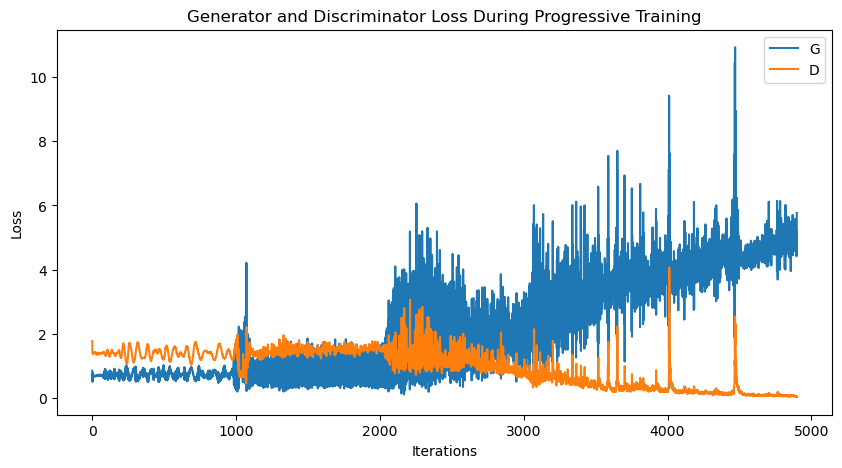

In [26]:
plt.figure(figsize=(10, 5))
plt.title("Generator and Discriminator Loss During Progressive Training")
plt.plot(G_losses, label="G")
plt.plot(D_losses, label="D")
plt.xlabel("Iterations")
plt.ylabel("Loss")
plt.legend()
plt.show()

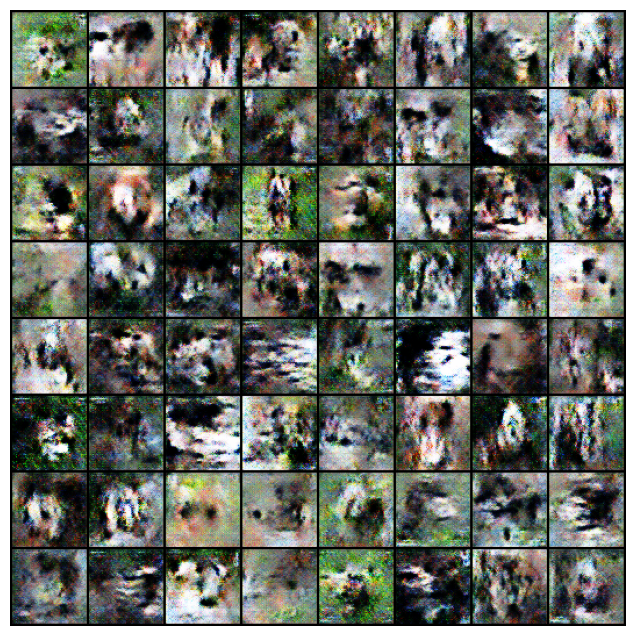

In [27]:
import matplotlib.pyplot as plt
import matplotlib.animation as animation
from IPython.display import HTML
import numpy as np

fig = plt.figure(figsize=(8,8))
plt.axis("off")
ims = [[plt.imshow(np.transpose(i,(1,2,0)), animated=True)] for i in img_list]
ani = animation.ArtistAnimation(fig, ims, interval=1000, repeat_delay=1000, blit=True)

HTML(ani.to_jshtml())

In [28]:
import torch

# Generate the first random latent vector
z_start = torch.randn(1, nz, 1, 1, device=device)
print(f"Generated z_start with shape: {z_start.shape}")

# Generate the second random latent vector
z_end = torch.randn(1, nz, 1, 1, device=device)
print(f"Generated z_end with shape: {z_end.shape}")

Generated z_start with shape: torch.Size([1, 100, 1, 1])
Generated z_end with shape: torch.Size([1, 100, 1, 1])


In [29]:
import torch

# 1. Define the number of interpolation steps
num_interpolation_steps = 16 # For example, 16 steps

# 2. Create a list or tensor of interpolation weights (alpha values)
interpolation_weights = torch.linspace(0, 1, num_interpolation_steps, device=device)
print(f"Interpolation weights generated: {interpolation_weights.shape}")

# 3. Initialize an empty list to store the interpolated latent vectors
interpolated_latent_vectors = []

# 4. Iterate through the interpolation weights and calculate interpolated latent vectors
for alpha in interpolation_weights:
    # interpolated_z = (1 - alpha) * z_start + alpha * z_end
    interpolated_z = (1 - alpha) * z_start + alpha * z_end
    
    # 5. Append each interpolated_z to the list
    interpolated_latent_vectors.append(interpolated_z)

print(f"Generated {len(interpolated_latent_vectors)} interpolated latent vectors.")
print(f"Shape of each interpolated vector: {interpolated_latent_vectors[0].shape}")

Interpolation weights generated: torch.Size([16])
Generated 16 interpolated latent vectors.
Shape of each interpolated vector: torch.Size([1, 100, 1, 1])


In [30]:
import torch
import numpy as np
import torchvision.utils as vutils

# 1. Set the netG_progressive model to evaluation mode
netG_progressive.eval()

# Ensure the generator is set to the highest resolution stage and fully faded in for final image generation
# resolutions[-1] corresponds to 64
final_resolution_idx = len(resolutions) - 1
netG_progressive.current_stage = final_resolution_idx
netG_progressive.set_alpha(1.0)
print(f"Generator set to final stage: {netG_progressive.current_stage} and alpha: {netG_progressive.alpha}")

# 2. Initialize an empty list to store the generated images
generated_images = []

# 3. Iterate through each latent vector in the interpolated_latent_vectors list
for i, z_vector in enumerate(interpolated_latent_vectors):
    # 4. Use a with torch.no_grad(): block to pass it through the netG_progressive model
    with torch.no_grad():
        # Generate image, ensure it's on the correct device
        # The generator already applies Tanh to output values between -1 and 1
        img = netG_progressive(z_vector)

    # 5. Move the generated image tensor to the CPU and process for visualization
    # normalize=True scales tensor values from (-1, 1) to (0, 1) for image display
    # make_grid is useful for displaying multiple images, but for single image, can directly transpose
    single_image_grid = vutils.make_grid(img, padding=0, normalize=True)
    
    # Convert to NumPy and permute dimensions for matplotlib (C, H, W -> H, W, C)
    np_image = single_image_grid.cpu().numpy().transpose(1, 2, 0)
    
    # 6. Append the processed image to the generated_images list
    generated_images.append(np_image)

print(f"Generated {len(generated_images)} images from interpolated latent vectors.")
print(f"Shape of each generated image: {generated_images[0].shape}")

Generator set to final stage: 4 and alpha: 1.0
Generated 16 images from interpolated latent vectors.
Shape of each generated image: (64, 64, 3)


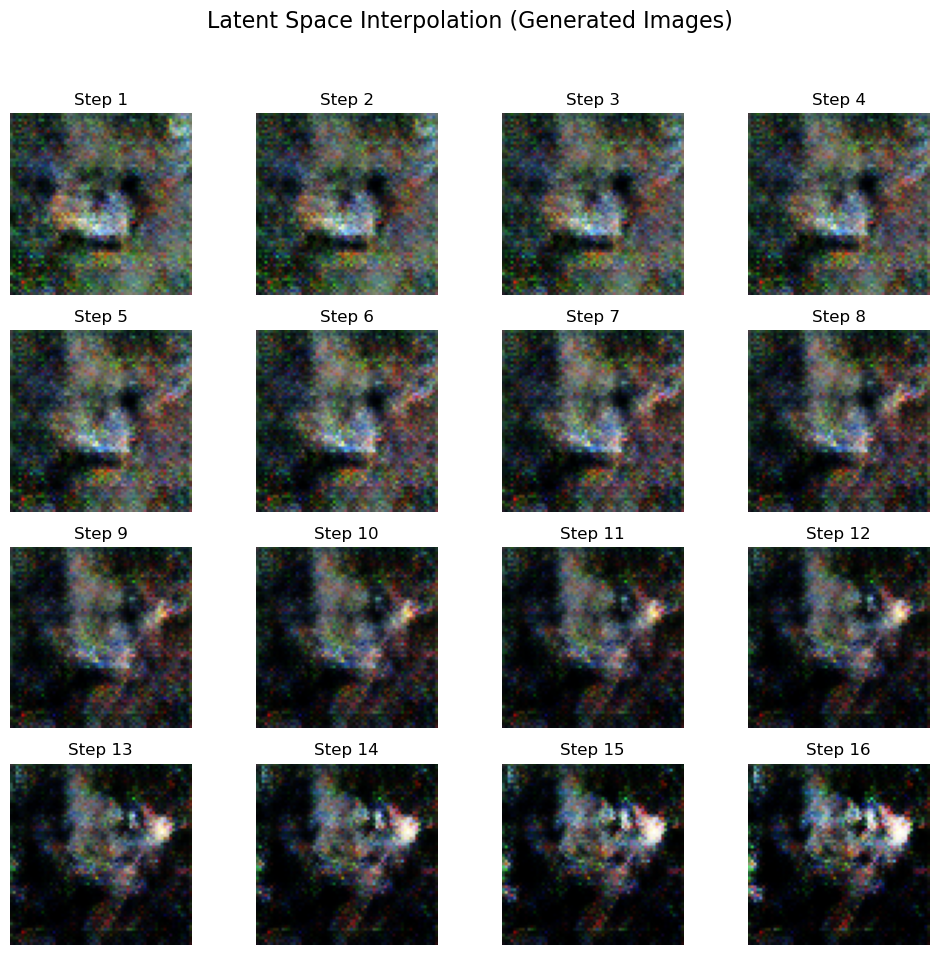

In [31]:
import matplotlib.pyplot as plt

# Assuming num_interpolation_steps is 16 and generated_images list is available
# Determine grid dimensions (e.g., 4x4 for 16 images)
grid_size = int(np.sqrt(len(generated_images)))

plt.figure(figsize=(10, 10))
plt.suptitle("Latent Space Interpolation (Generated Images)", fontsize=16)

for i, img in enumerate(generated_images):
    plt.subplot(grid_size, grid_size, i + 1)
    plt.imshow(img)
    plt.axis('off')
    plt.title(f"Step {i+1}")

plt.tight_layout(rect=[0, 0.03, 1, 0.95]) # Adjust layout to prevent title overlap
plt.show()

In [1]:
import torch
import torch.nn as nn
import torch.nn.functional as F
from einops import rearrange #pip install einops
from typing import List
import random
import math
from torchvision import datasets, transforms
from torch.utils.data import DataLoader 
from timm.utils import ModelEmaV3 #pip install timm 
from tqdm import tqdm #pip install tqdm
import matplotlib.pyplot as plt #pip install matplotlib
import torch.optim as optim
import numpy as np

class SinusoidalEmbeddings(nn.Module):
    def __init__(self, time_steps:int, embed_dim: int):
        super().__init__()
        position = torch.arange(time_steps).unsqueeze(1).float()
        div = torch.exp(torch.arange(0, embed_dim, 2).float() * -(math.log(10000.0) / embed_dim))
        embeddings = torch.zeros(time_steps, embed_dim, requires_grad=False)
        embeddings[:, 0::2] = torch.sin(position * div)
        embeddings[:, 1::2] = torch.cos(position * div)
        self.embeddings = embeddings

    def forward(self, x, t):
        embeds = self.embeddings[t].to(x.device)
        return embeds[:, :, None, None]

In [2]:
# Residual Blocks
class ResBlock(nn.Module):
    def __init__(self, C: int, num_groups: int, dropout_prob: float):
        super().__init__()
        self.relu = nn.ReLU(inplace=True)
        self.gnorm1 = nn.GroupNorm(num_groups=num_groups, num_channels=C)
        self.gnorm2 = nn.GroupNorm(num_groups=num_groups, num_channels=C)
        self.conv1 = nn.Conv2d(C, C, kernel_size=3, padding=1)
        self.conv2 = nn.Conv2d(C, C, kernel_size=3, padding=1)
        self.dropout = nn.Dropout(p=dropout_prob, inplace=True)

    def forward(self, x, embeddings):
        x = x + embeddings[:, :x.shape[1], :, :]
        r = self.conv1(self.relu(self.gnorm1(x)))
        r = self.dropout(r)
        r = self.conv2(self.relu(self.gnorm2(r)))
        return r + x

In [3]:
class Attention(nn.Module):
    def __init__(self, C: int, num_heads:int , dropout_prob: float):
        super().__init__()
        self.proj1 = nn.Linear(C, C*3)
        self.proj2 = nn.Linear(C, C)
        self.num_heads = num_heads
        self.dropout_prob = dropout_prob

    def forward(self, x):
        h, w = x.shape[2:]
        x = rearrange(x, 'b c h w -> b (h w) c')
        x = self.proj1(x)
        x = rearrange(x, 'b L (C H K) -> K b H L C', K=3, H=self.num_heads)
        q,k,v = x[0], x[1], x[2]
        x = F.scaled_dot_product_attention(q,k,v, is_causal=False, dropout_p=self.dropout_prob)
        x = rearrange(x, 'b H (h w) C -> b h w (C H)', h=h, w=w)
        x = self.proj2(x)
        return rearrange(x, 'b h w C -> b C h w')

In [4]:
class UnetLayer(nn.Module):
    def __init__(self, 
            upscale: bool, 
            attention: bool, 
            num_groups: int, 
            dropout_prob: float,
            num_heads: int,
            C: int):
        super().__init__()
        self.ResBlock1 = ResBlock(C=C, num_groups=num_groups, dropout_prob=dropout_prob)
        self.ResBlock2 = ResBlock(C=C, num_groups=num_groups, dropout_prob=dropout_prob)
        if upscale:
            self.conv = nn.ConvTranspose2d(C, C//2, kernel_size=4, stride=2, padding=1)
        else:
            self.conv = nn.Conv2d(C, C*2, kernel_size=3, stride=2, padding=1)
        if attention:
            self.attention_layer = Attention(C, num_heads=num_heads, dropout_prob=dropout_prob)

    def forward(self, x, embeddings):
        x = self.ResBlock1(x, embeddings)
        if hasattr(self, 'attention_layer'):
            x = self.attention_layer(x)
        x = self.ResBlock2(x, embeddings)
        return self.conv(x), x

In [5]:
class UNET(nn.Module):
    def __init__(self,
            Channels: List = [64, 128, 256, 512, 512, 384],
            Attentions: List = [False, True, False, False, False, True],
            Upscales: List = [False, False, False, True, True, True],
            num_groups: int = 32,
            dropout_prob: float = 0.1,
            num_heads: int = 8,
            input_channels: int = 3,
            output_channels: int = 3,
            time_steps: int = 1000):
        super().__init__()
        self.num_layers = len(Channels)
        self.shallow_conv = nn.Conv2d(input_channels, Channels[0], kernel_size=3, padding=1)
        out_channels = (Channels[-1]//2)+Channels[0]
        self.late_conv = nn.Conv2d(out_channels, out_channels//2, kernel_size=3, padding=1)
        self.output_conv = nn.Conv2d(out_channels//2, output_channels, kernel_size=1)
        self.relu = nn.ReLU(inplace=True)
        self.embeddings = SinusoidalEmbeddings(time_steps=time_steps, embed_dim=max(Channels))
        for i in range(self.num_layers):
            layer = UnetLayer(
                upscale=Upscales[i],
                attention=Attentions[i],
                num_groups=num_groups,
                dropout_prob=dropout_prob,
                C=Channels[i],
                num_heads=num_heads
            )
            setattr(self, f'Layer{i+1}', layer)

    def forward(self, x, t):
        x = self.shallow_conv(x)
        residuals = []
        for i in range(self.num_layers//2):
            layer = getattr(self, f'Layer{i+1}')
            embeddings = self.embeddings(x, t)
            x, r = layer(x, embeddings)
            residuals.append(r)
        for i in range(self.num_layers//2, self.num_layers):
            layer = getattr(self, f'Layer{i+1}')
            x = torch.concat((layer(x, embeddings)[0], residuals[self.num_layers-i-1]), dim=1)
        return self.output_conv(self.relu(self.late_conv(x)))

In [6]:
class DDPM_Scheduler(nn.Module):
    def __init__(self, num_time_steps: int=1000):
        super().__init__()
        self.beta = torch.linspace(1e-4, 0.02, num_time_steps, requires_grad=False)
        alpha = 1 - self.beta
        self.alpha = torch.cumprod(alpha, dim=0).requires_grad_(False)

    def forward(self, t):
        return self.beta[t], self.alpha[t]

In [7]:
def set_seed(seed: int = 42):
    torch.manual_seed(seed)
    torch.cuda.manual_seed_all(seed)
    torch.backends.cudnn.deterministic = True
    torch.backends.cudnn.benchmark = False
    np.random.seed(seed)
    random.seed(seed)

In [8]:
import os
import random
import torch
import torch.nn as nn
import torch.optim as optim
import torch.nn.functional as F
from torch.utils.data import Dataset, DataLoader
from torchvision import transforms
from PIL import Image
from tqdm import tqdm

# Custom Dataset class
class CustomImageDataset(Dataset):
    """Custom Dataset for loading images from a directory."""
    def __init__(self, img_directory, transform=None):
        self.img_directory = img_directory
        self.transform = transform
        
        # Get all image files
        self.image_files = [f for f in os.listdir(img_directory) 
                           if f.lower().endswith(('.png', '.jpg', '.jpeg', '.bmp', '.gif'))]
        
        if len(self.image_files) == 0:
            raise ValueError(f"No images found in {img_directory}")
        
        print(f"Found {len(self.image_files)} images in {img_directory}")
    
    def __len__(self):
        return len(self.image_files)
    
    def __getitem__(self, idx):
        img_path = os.path.join(self.img_directory, self.image_files[idx])
        image = Image.open(img_path).convert('RGB')
        
        if self.transform:
            image = self.transform(image)
        
        return image, 0

def train(batch_size: int=32,
          num_time_steps: int=1000,
          num_epochs: int=15,
          seed: int=-1,
          ema_decay: float=0.9999,
          lr=2e-5,
          checkpoint_path: str=None,
          img_directory: str='/home/zmanita/pandas_images',
          img_size: int=64):
    
    # Disable deterministic algorithms for training
    torch.use_deterministic_algorithms(False)
    
    set_seed(random.randint(0, 2**32-1)) if seed == -1 else set_seed(seed)
    
    transform = transforms.Compose([
        transforms.Resize((img_size, img_size)),
        transforms.ToTensor(),
    ])
    
    train_dataset = CustomImageDataset(img_directory=img_directory, transform=transform)
    train_loader = DataLoader(train_dataset, batch_size=batch_size, shuffle=True, 
                             drop_last=True, num_workers=4)
    
    scheduler = DDPM_Scheduler(num_time_steps=num_time_steps)
    model = UNET().cuda()
    optimizer = optim.Adam(model.parameters(), lr=lr)
    ema = ModelEmaV3(model, decay=ema_decay)
    
    # Only load checkpoint if it exists
    if checkpoint_path is not None and os.path.exists(checkpoint_path):
        print(f"Loading checkpoint from {checkpoint_path}")
        checkpoint = torch.load(checkpoint_path)
        model.load_state_dict(checkpoint['weights'])
        ema.load_state_dict(checkpoint['ema'])
        optimizer.load_state_dict(checkpoint['optimizer'])
        print("Checkpoint loaded successfully!")
    elif checkpoint_path is not None:
        print(f"Checkpoint path provided but file not found: {checkpoint_path}")
        print("Starting training from scratch...")
    
    criterion = nn.MSELoss(reduction='mean')
    
    for i in range(num_epochs):
        total_loss = 0
        for bidx, (x, _) in enumerate(tqdm(train_loader, desc=f"Epoch {i+1}/{num_epochs}")):
            x = x.cuda()
            
            t = torch.randint(0, num_time_steps, (x.shape[0],))
            e = torch.randn_like(x, requires_grad=False)
            a = scheduler.alpha[t].view(x.shape[0], 1, 1, 1).cuda()
            x = (torch.sqrt(a) * x) + (torch.sqrt(1 - a) * e)
            
            output = model(x, t)
            
            optimizer.zero_grad()
            loss = criterion(output, e)
            total_loss += loss.item()
            loss.backward()
            optimizer.step()
            ema.update(model)
        
        avg_loss = total_loss / len(train_loader)
        print(f'Epoch {i+1} | Loss {avg_loss:.5f}')
    
    # Create checkpoints directory if it doesn't exist
    os.makedirs('checkpoints', exist_ok=True)
    
    checkpoint = {
        'weights': model.state_dict(),
        'optimizer': optimizer.state_dict(),
        'ema': ema.state_dict()
    }
    torch.save(checkpoint, '/home/zmanita/checkpoints/ddpm_checkpoint')
    print("Model checkpoint saved to '/home/zmanita/checkpoints/ddpm_checkpoint'")

# Run training
train(batch_size=32, num_epochs=15, img_directory='/home/zmanita/pandas_images', img_size=64)

Found 24997 images in /home/zmanita/pandas_images


Epoch 1/15: 100%|██████████| 781/781 [02:36<00:00,  5.01it/s]


Epoch 1 | Loss 0.22691


Epoch 2/15: 100%|██████████| 781/781 [01:40<00:00,  7.75it/s]


Epoch 2 | Loss 0.08439


Epoch 3/15: 100%|██████████| 781/781 [01:40<00:00,  7.80it/s]


Epoch 3 | Loss 0.05879


Epoch 4/15: 100%|██████████| 781/781 [01:40<00:00,  7.78it/s]


Epoch 4 | Loss 0.04829


Epoch 5/15: 100%|██████████| 781/781 [01:37<00:00,  8.05it/s]


Epoch 5 | Loss 0.04104


Epoch 6/15: 100%|██████████| 781/781 [01:38<00:00,  7.91it/s]


Epoch 6 | Loss 0.03743


Epoch 7/15: 100%|██████████| 781/781 [01:41<00:00,  7.70it/s]


Epoch 7 | Loss 0.03477


Epoch 8/15: 100%|██████████| 781/781 [01:36<00:00,  8.08it/s]


Epoch 8 | Loss 0.03297


Epoch 9/15: 100%|██████████| 781/781 [01:38<00:00,  7.94it/s]


Epoch 9 | Loss 0.03090


Epoch 10/15: 100%|██████████| 781/781 [01:38<00:00,  7.90it/s]


Epoch 10 | Loss 0.02934


Epoch 11/15: 100%|██████████| 781/781 [01:38<00:00,  7.92it/s]


Epoch 11 | Loss 0.02866


Epoch 12/15: 100%|██████████| 781/781 [01:37<00:00,  8.02it/s]


Epoch 12 | Loss 0.02792


Epoch 13/15: 100%|██████████| 781/781 [01:37<00:00,  8.02it/s]


Epoch 13 | Loss 0.02684


Epoch 14/15: 100%|██████████| 781/781 [01:41<00:00,  7.71it/s]


Epoch 14 | Loss 0.02546


Epoch 15/15: 100%|██████████| 781/781 [01:37<00:00,  8.04it/s]


Epoch 15 | Loss 0.02590
Model checkpoint saved to '/home/zmanita/checkpoints/ddpm_checkpoint'


In [9]:
def display_reverse(images: List):
    fig, axes = plt.subplots(1, 10, figsize=(10, 1))
    for i, ax in enumerate(axes.flat):
        x = images[i].squeeze(0)
        x = rearrange(x, 'c h w -> h w c')
        x = x.cpu().numpy()
        x = np.clip(x, 0, 1)  # Clip values to valid range
        ax.imshow(x)
        ax.axis('off')
    plt.show()

def inference(checkpoint_path: str=None,
              num_time_steps: int=1000,
              ema_decay: float=0.9999,
              num_samples: int=10,
              img_size: int=64):
    
    checkpoint = torch.load(checkpoint_path)
    
    # Initialize model with correct parameters
    model = UNET(
        input_channels=3,
        output_channels=3,
        time_steps=num_time_steps
    ).cuda()
    
    model.load_state_dict(checkpoint['weights'])
    ema = ModelEmaV3(model, decay=ema_decay)
    ema.load_state_dict(checkpoint['ema'])
    scheduler = DDPM_Scheduler(num_time_steps=num_time_steps)
    
    times = [0, 15, 50, 100, 200, 300, 400, 550, 700, 999]
    
    with torch.no_grad():
        model = ema.module.eval()
        
        for sample_idx in range(num_samples):
            images = []
            
            # Initialize with random noise - correct size for 64x64 RGB images
            z = torch.randn(1, 3, img_size, img_size).cuda()
            
            # Reverse diffusion process
            for t in reversed(range(1, num_time_steps)):
                t_tensor = torch.tensor([t], dtype=torch.long)
                
                # Get model prediction
                predicted_noise = model(z, t_tensor)
                
                # Compute denoising step
                beta_t = scheduler.beta[t].view(1, 1, 1, 1).cuda()
                alpha_t = scheduler.alpha[t].view(1, 1, 1, 1).cuda()
                
                temp = beta_t / (torch.sqrt(1 - alpha_t) * torch.sqrt(1 - beta_t))
                z = (1 / torch.sqrt(1 - beta_t)) * z - (temp * predicted_noise)
                
                # Save intermediate images at specified timesteps
                if t in times:
                    images.append(z.cpu())
                
                # Add noise for next step (except for t=1)
                if t > 1:
                    noise = torch.randn_like(z)
                    z = z + (noise * torch.sqrt(beta_t))
            
            # Final denoising step at t=0
            t_tensor = torch.tensor([0], dtype=torch.long)
            beta_0 = scheduler.beta[0].view(1, 1, 1, 1).cuda()
            alpha_0 = scheduler.alpha[0].view(1, 1, 1, 1).cuda()
            
            predicted_noise = model(z, t_tensor)
            temp = beta_0 / (torch.sqrt(1 - alpha_0) * torch.sqrt(1 - beta_0))
            x = (1 / torch.sqrt(1 - beta_0)) * z - (temp * predicted_noise)
            
            images.append(x.cpu())
            
            # Display final generated image
            x_display = x.squeeze(0).cpu()
            x_display = rearrange(x_display, 'c h w -> h w c')
            x_display = x_display.numpy()
            x_display = np.clip(x_display, 0, 1)
            
            plt.figure(figsize=(5, 5))
            plt.imshow(x_display)
            plt.title(f'Generated Sample {sample_idx + 1}')
            plt.axis('off')
            plt.show()
            
            # Display reverse diffusion process
            if len(images) >= 10:
                display_reverse(images[-10:])  # Show last 10 timesteps
            
            images = []

In [11]:
def main():
    train(checkpoint_path='/home/zmanita/checkpoints/ddpm_checkpoint', lr=2e-5, num_epochs=50, img_directory='/home/zmanita/pandas_images')
    inference('/home/zmanita/checkpoints/ddpm_checkpoint', num_samples=5)

if __name__ == '__main__':
    main()

Found 24997 images in /home/zmanita/pandas_images
Loading checkpoint from /home/zmanita/checkpoints/ddpm_checkpoint
Checkpoint loaded successfully!


Epoch 1/50:  29%|██▊       | 223/781 [00:28<01:10,  7.90it/s]


KeyboardInterrupt: 

In [12]:
import matplotlib.pyplot as plt
import numpy as np
from einops import rearrange
import torch

def visualize_forward_diffusion(image_path: str, 
                                num_time_steps: int=1000,
                                timesteps_to_show: list=[0, 50, 100, 200, 300, 400, 500, 600, 700, 999]):
    """
    Visualize the forward diffusion process (image getting progressively noisier).
    
    Args:
        image_path: Path to the input image
        num_time_steps: Total number of diffusion timesteps
        timesteps_to_show: List of timesteps to display
    """
    # Load and preprocess image
    from PIL import Image
    from torchvision import transforms
    
    transform = transforms.Compose([
        transforms.Resize((64, 64)),
        transforms.ToTensor(),
    ])
    
    image = Image.open(image_path).convert('RGB')
    x = transform(image).unsqueeze(0).cuda()  # Shape: [1, 3, 64, 64]
    
    # Initialize scheduler
    scheduler = DDPM_Scheduler(num_time_steps=num_time_steps)
    
    # Generate noisy versions
    noisy_images = []
    
    with torch.no_grad():
        for t in timesteps_to_show:
            # Sample noise
            noise = torch.randn_like(x)
            
            # Get alpha value for this timestep
            alpha_t = scheduler.alpha[t].view(1, 1, 1, 1).cuda()
            
            # Apply noise according to the diffusion equation
            x_noisy = torch.sqrt(alpha_t) * x + torch.sqrt(1 - alpha_t) * noise
            
            noisy_images.append(x_noisy.cpu())
    
    # Display the forward diffusion process
    fig, axes = plt.subplots(1, len(timesteps_to_show), figsize=(20, 2))
    fig.suptitle('Forward Diffusion Process: Image Getting Progressively Noisier', 
                 fontsize=16, fontweight='bold')
    
    for i, (ax, t) in enumerate(zip(axes.flat, timesteps_to_show)):
        img = noisy_images[i].squeeze(0)
        img = rearrange(img, 'c h w -> h w c').numpy()
        img = np.clip(img, 0, 1)
        
        ax.imshow(img)
        ax.set_title(f't = {t}', fontsize=12)
        ax.axis('off')
    
    plt.tight_layout()
    plt.savefig('forward_diffusion_process.png', dpi=150, bbox_inches='tight')
    plt.show()
    print("Forward diffusion visualization saved as 'forward_diffusion_process.png'")


def visualize_reverse_diffusion(checkpoint_path: str,
                                num_time_steps: int=1000,
                                timesteps_to_show: list=[999, 700, 500, 400, 300, 200, 100, 50, 10, 0],
                                img_size: int=64):
    """
    Visualize the reverse diffusion process (denoising from noise to image).
    
    Args:
        checkpoint_path: Path to the trained model checkpoint
        num_time_steps: Total number of diffusion timesteps
        timesteps_to_show: List of timesteps to display (should be in descending order)
    """
    # Load model
    checkpoint = torch.load(checkpoint_path)
    model = UNET(
        input_channels=3,
        output_channels=3,
        time_steps=num_time_steps
    ).cuda()
    model.load_state_dict(checkpoint['weights'])
    
    ema = ModelEmaV3(model, decay=0.9999)
    ema.load_state_dict(checkpoint['ema'])
    
    scheduler = DDPM_Scheduler(num_time_steps=num_time_steps)
    
    denoised_images = []
    
    with torch.no_grad():
        model = ema.module.eval()
        
        # Start with pure noise
        z = torch.randn(1, 3, img_size, img_size).cuda()
        
        # Store initial noise
        if 999 in timesteps_to_show:
            denoised_images.append((999, z.cpu().clone()))
        
        # Reverse diffusion process
        for t in reversed(range(1, num_time_steps)):
            t_tensor = torch.tensor([t], dtype=torch.long)
            
            # Get model prediction
            predicted_noise = model(z, t_tensor)
            
            # Compute denoising step
            beta_t = scheduler.beta[t].view(1, 1, 1, 1).cuda()
            alpha_t = scheduler.alpha[t].view(1, 1, 1, 1).cuda()
            
            temp = beta_t / (torch.sqrt(1 - alpha_t) * torch.sqrt(1 - beta_t))
            z = (1 / torch.sqrt(1 - beta_t)) * z - (temp * predicted_noise)
            
            # Save image at specified timesteps
            if t in timesteps_to_show:
                denoised_images.append((t, z.cpu().clone()))
            
            # Add noise for next step
            if t > 1:
                noise = torch.randn_like(z)
                z = z + (noise * torch.sqrt(beta_t))
        
        # Final denoising step at t=0
        t_tensor = torch.tensor([0], dtype=torch.long)
        beta_0 = scheduler.beta[0].view(1, 1, 1, 1).cuda()
        alpha_0 = scheduler.alpha[0].view(1, 1, 1, 1).cuda()
        
        predicted_noise = model(z, t_tensor)
        temp = beta_0 / (torch.sqrt(1 - alpha_0) * torch.sqrt(1 - beta_0))
        x = (1 / torch.sqrt(1 - beta_0)) * z - (temp * predicted_noise)
        
        if 0 in timesteps_to_show:
            denoised_images.append((0, x.cpu().clone()))
    
    # Sort images by timestep (descending order for visualization)
    denoised_images.sort(key=lambda x: x[0], reverse=True)
    
    # Display the reverse diffusion process
    fig, axes = plt.subplots(1, len(denoised_images), figsize=(20, 2))
    fig.suptitle('Reverse Diffusion Process: Denoising from Noise to Image Sample', 
                 fontsize=16, fontweight='bold')
    
    for i, (ax, (t, img_tensor)) in enumerate(zip(axes.flat, denoised_images)):
        img = img_tensor.squeeze(0)
        img = rearrange(img, 'c h w -> h w c').numpy()
        img = np.clip(img, 0, 1)
        
        ax.imshow(img)
        ax.set_title(f't = {t}', fontsize=12)
        ax.axis('off')
    
    plt.tight_layout()
    plt.savefig('reverse_diffusion_process.png', dpi=150, bbox_inches='tight')
    plt.show()
    print("Reverse diffusion visualization saved as 'reverse_diffusion_process.png'")


def visualize_both_processes(image_path: str,
                             checkpoint_path: str,
                             num_time_steps: int=1000):
    """
    Visualize both forward and reverse diffusion processes.
    """
    print("=" * 80)
    print("VISUALIZING FORWARD DIFFUSION (Encoding: Image → Noise)")
    print("=" * 80)
    visualize_forward_diffusion(
        image_path=image_path,
        num_time_steps=num_time_steps,
        timesteps_to_show=[0, 50, 100, 200, 300, 400, 500, 600, 700, 999]
    )
    
    print("\n" + "=" * 80)
    print("VISUALIZING REVERSE DIFFUSION (Decoding: Noise → Image)")
    print("=" * 80)
    visualize_reverse_diffusion(
        checkpoint_path=checkpoint_path,
        num_time_steps=num_time_steps,
        timesteps_to_show=[999, 700, 500, 400, 300, 200, 100, 50, 10, 0]
    )

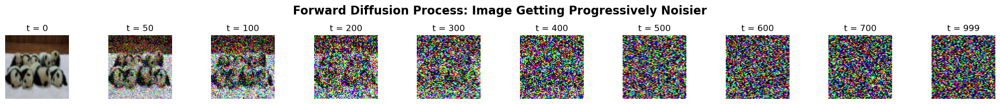

Forward diffusion visualization saved as 'forward_diffusion_process.png'


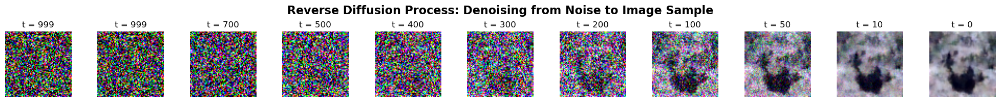

Reverse diffusion visualization saved as 'reverse_diffusion_process.png'


In [14]:
# After training is complete, run this to generate visualizations

# 1. Forward diffusion (encoding)
visualize_forward_diffusion(
    image_path='/home/zmanita/pandas_images/0_2.png',  # Change to any panda image
    num_time_steps=1000,
    timesteps_to_show=[0, 50, 100, 200, 300, 400, 500, 600, 700, 999]
)

# 2. Reverse diffusion (decoding)
visualize_reverse_diffusion(
    checkpoint_path='/home/zmanita/checkpoints/ddpm_checkpoint',
    num_time_steps=1000,
    timesteps_to_show=[999, 700, 500, 400, 300, 200, 100, 50, 10, 0]
)